In [2]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
import os
import pickle

%matplotlib inline

In [3]:
CAMERA_CAL_PATH = './camera_cal'
EXAMPLES_PATH = './examples'
OUTPUT_PATH = './output_images'
TEST_PATH = './test_images'
TEST_CHALLENGE_PATH = './test_images_challenge'
PROJECT_VIDEO_PATH = './project_video.mp4'
CHALLENGE_VIDEO_PATH = './challenge_video.mp4'
HARDER_CHALLENGE_VIDEO_PATH = './harder_challenge_video.mp4'

In [4]:
calibration_params = pickle.load(open('calibraiton_params.p', 'rb'))

In [97]:
def undistort(img, calibration_img_path='./camera_cal/calibration2.jpg'):
    [mtx, dist, rvecs, tvecs, M, Minv] = calibration_params[calibration_img_path]
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

def color_thresholding(img, space='rgb', binary=True, thresh=(200, 255),
                       cliplimit=2.0, equalize=False, plot=False):
    new_img = img
    if space == 'hsv':
        new_img = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    elif space == 'hls':
        new_img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    elif space == 'lab':
        new_img = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
    elif space == 'luv':
        new_img = cv2.cvtColor(img, cv2.COLOR_RGB2Luv)
    elif space == 'yuv':
        new_img = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
    elif space == 'ycrcb':
        new_img = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    
    img_ch1 = new_img[:,:,0]
    img_ch2 = new_img[:,:,1]
    img_ch3 = new_img[:,:,2]
    
    if equalize:
        clahe = cv2.createCLAHE(clipLimit=cliplimit, tileGridSize=(8, 8))
#         img_ch1 = clahe.apply(img_ch1)
#         img_ch2 = clahe.apply(img_ch2)
#         img_ch3 = clahe.apply(img_ch3)
        img_ch1 = cv2.equalizeHist(img_ch1)
        img_ch2 = cv2.equalizeHist(img_ch2)
        img_ch3 = cv2.equalizeHist(img_ch3)

    if binary:
        thresh_ch1 = np.zeros_like(img_ch1)
        thresh_ch2 = np.zeros_like(img_ch2)
        thresh_ch3 = np.zeros_like(img_ch3)

        thresh_ch1[(img_ch1 > thresh[0]) & (img_ch1 <= thresh[1])] = 1
        thresh_ch2[(img_ch2 > thresh[0]) & (img_ch2 <= thresh[1])] = 1
        thresh_ch3[(img_ch3 > thresh[0]) & (img_ch3 <= thresh[1])] = 1
        
        img_ch1 = thresh_ch1
        img_ch2 = thresh_ch2
        img_ch3 = thresh_ch3
    
    if plot:
        f, ax = plt.subplots(1, 3, figsize=(40, 25))
        ax[0].imshow(img_ch1, cmap='gray')
        ax[0].set_title(space + ' ch1', fontsize=15)
        ax[1].imshow(img_ch2, cmap='gray')
        ax[1].set_title(space + ' ch2', fontsize=15)
        ax[2].imshow(img_ch3, cmap='gray')
        ax[2].set_title(space + ' ch3', fontsize=15)
    
    return img_ch1, img_ch2, img_ch3

def combined_color_thresholding(img):
    rgb_ch1, rgb_ch2, rgb_ch3 = color_thresholding(img, space='rgb',
                                                   thresh=COLOR_SPACE_PARAMS['rgb']['thresh'],
                                                   cliplimit=COLOR_SPACE_PARAMS['rgb']['cliplimit'],
                                                   equalize=True)
#     hls_ch1, hls_ch2, hls_ch3 = color_thresholding(img, space='hls',
#                                                    thresh=COLOR_SPACE_PARAMS['hls']['thresh'],
#                                                    cliplimit=COLOR_SPACE_PARAMS['hls']['cliplimit'])
    hsv_ch1, hsv_ch2, hsv_ch3 = color_thresholding(img, space='hsv',
                                                   thresh=COLOR_SPACE_PARAMS['hsv']['thresh'],
                                                   cliplimit=COLOR_SPACE_PARAMS['hsv']['cliplimit'],
                                                   equalize=True)
    luv_ch1, luv_ch2, luv_ch3 = color_thresholding(img, space='luv',
                                                   thresh=COLOR_SPACE_PARAMS['luv']['thresh'],
                                                   cliplimit=COLOR_SPACE_PARAMS['luv']['cliplimit'],
                                                   equalize=True)

    combined = np.zeros_like(rgb_ch1)
#     combined[((rgb_ch1 == 1) | (hls_ch3 == 1) | (hsv_ch3 == 1) | (luv_ch3 == 1))] = 1
    combined[((rgb_ch1 == 1) | (hsv_ch3 == 1) | (luv_ch3 == 1))] = 1
    return combined

# Taken from p1-lane-lines project
def region_of_interest(img, vertices):
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image
    
def birds_eye_perspective_transform(img):
    img = region_of_interest(img, np.int32([src]))
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, (img.shape[1], img.shape[0]), flags=cv2.INTER_LINEAR)
    return warped, M, Minv

def process_image(img, calibration_img_path = './camera_cal/calibration2.jpg', plot=False):
    # Undistortion
    undist = undistort(img, calibration_img_path)
    # Birds eye perspective transform
    warped, M, Minv = birds_eye_perspective_transform(undist)
    # Color thresholding
    combined = combined_color_thresholding(warped)  
    
    if plot:
        undist_copy = np.copy(undist)
        warped_copy = np.copy(warped)
        cv2.polylines(undist_copy, np.int32([src]), True, (255, 0, 0), 5)
        cv2.polylines(warped_copy, np.int32([dst]), True, (255, 0, 0), 5)
        f, ax = plt.subplots(2, 2, figsize=(10, 10))
        ax[0][0].imshow(undist)
        ax[0][0].set_title('Undistorted Image', fontsize=15)
        ax[0][1].imshow(undist_copy)
        ax[0][1].set_title('ROI Image', fontsize=15)
        ax[1][0].imshow(warped_copy)
        ax[1][0].set_title('Warped Image', fontsize=15)        
        ax[1][1].imshow(combined, cmap='gray')
        ax[1][1].set_title('Combined thresholded Image', fontsize=15)
    return combined, undist, warped, Minv

./camera_cal/calibration10.jpg
./test_images_challenge/test1.jpg


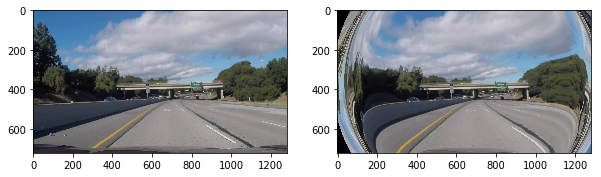

./test_images_challenge/test3.jpg


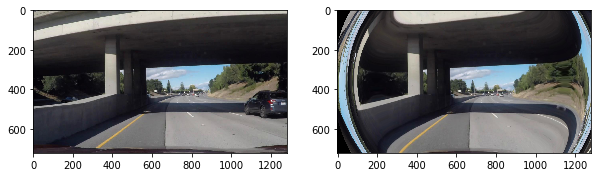

./test_images_challenge/test4.jpg


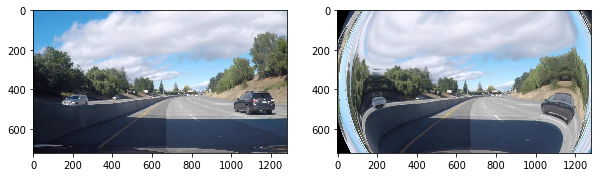

./test_images_challenge/test5.jpg


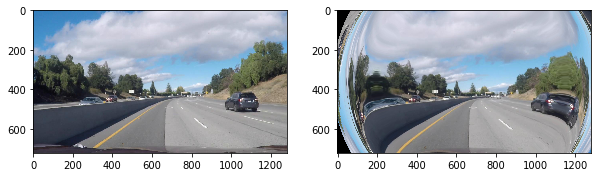

./test_images_challenge/test2.jpg


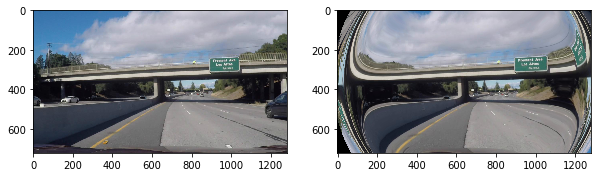

./test_images_challenge/test6.jpg


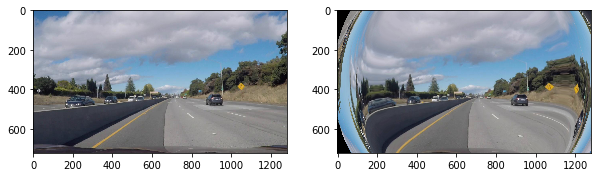

./camera_cal/calibration15.jpg
./test_images_challenge/test1.jpg


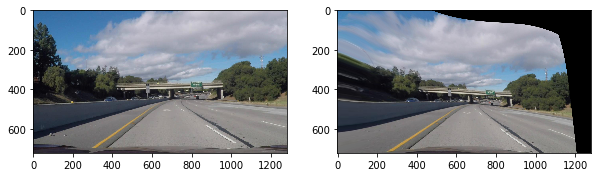

./test_images_challenge/test3.jpg


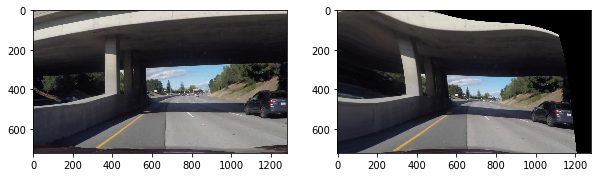

./test_images_challenge/test4.jpg


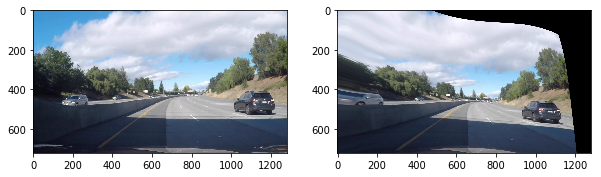

./test_images_challenge/test5.jpg


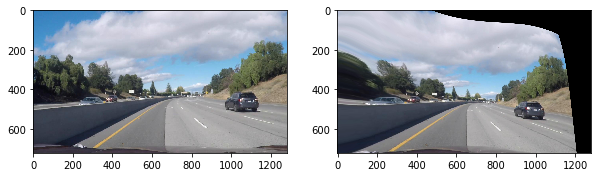

./test_images_challenge/test2.jpg


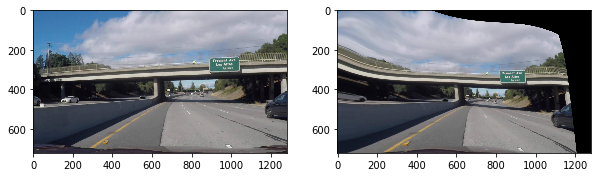

./test_images_challenge/test6.jpg


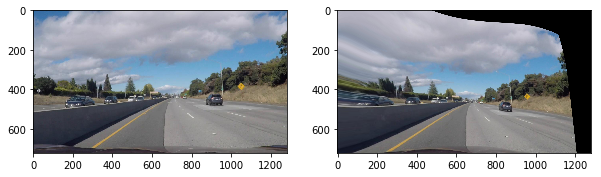

./camera_cal/calibration19.jpg
./test_images_challenge/test1.jpg


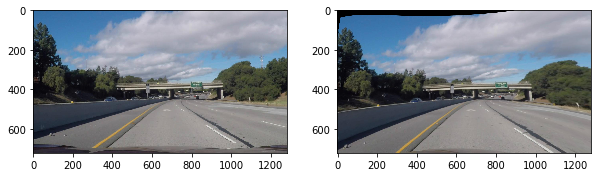

./test_images_challenge/test3.jpg


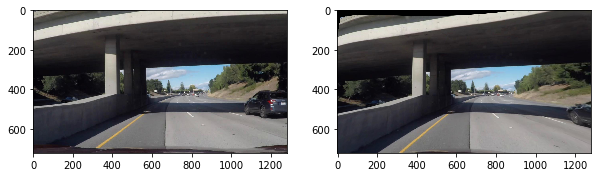

./test_images_challenge/test4.jpg


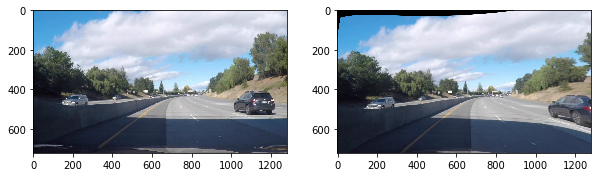

./test_images_challenge/test5.jpg


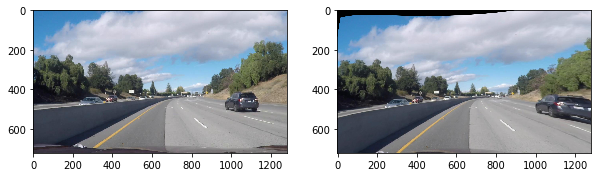

./test_images_challenge/test2.jpg


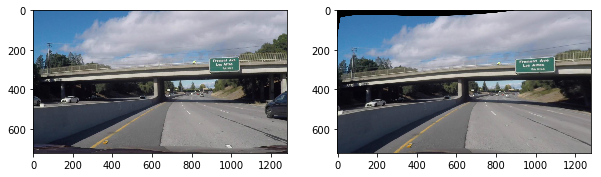

./test_images_challenge/test6.jpg


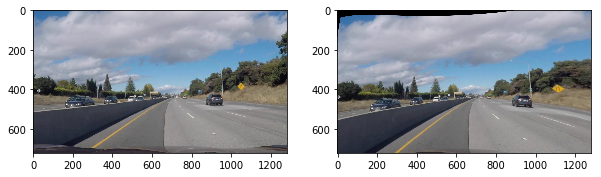

./camera_cal/calibration17.jpg
./test_images_challenge/test1.jpg


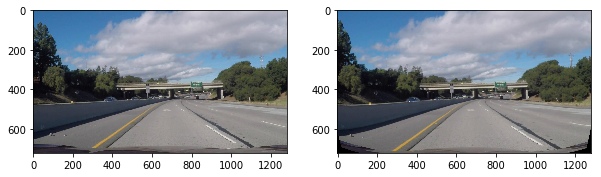

./test_images_challenge/test3.jpg


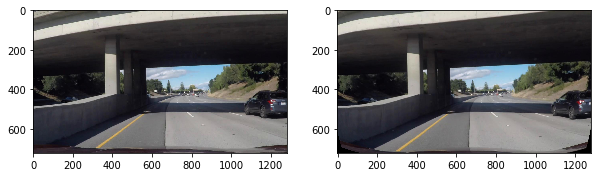

./test_images_challenge/test4.jpg


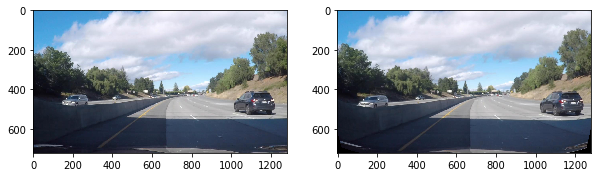

./test_images_challenge/test5.jpg


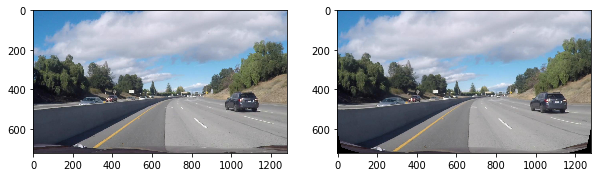

./test_images_challenge/test2.jpg


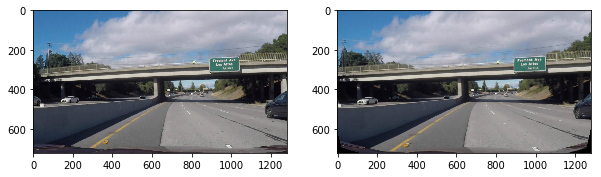

./test_images_challenge/test6.jpg


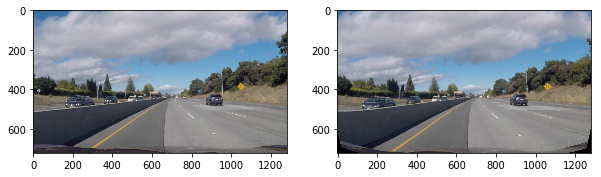

./camera_cal/calibration7.jpg
./test_images_challenge/test1.jpg


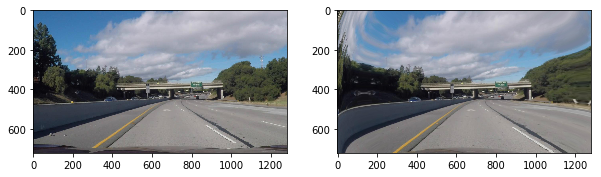

./test_images_challenge/test3.jpg


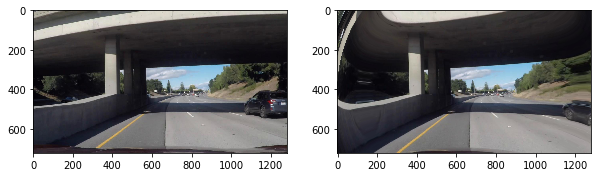

./test_images_challenge/test4.jpg


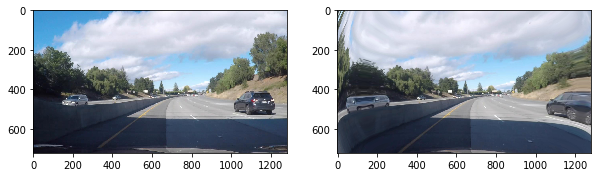

./test_images_challenge/test5.jpg


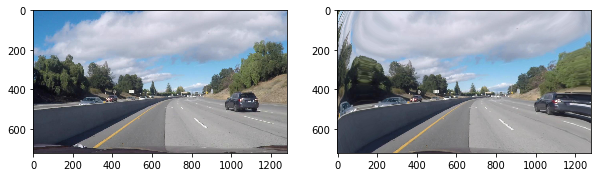

./test_images_challenge/test2.jpg


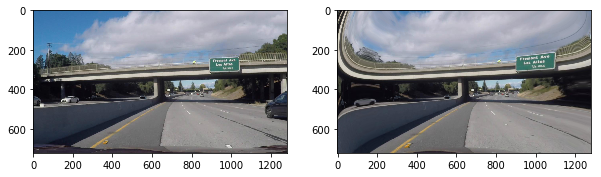

./test_images_challenge/test6.jpg


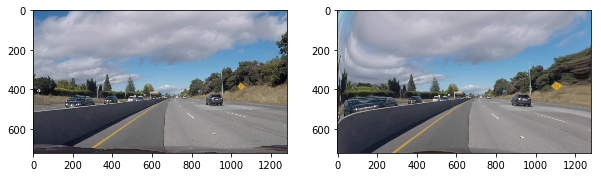

./camera_cal/calibration14.jpg
./test_images_challenge/test1.jpg


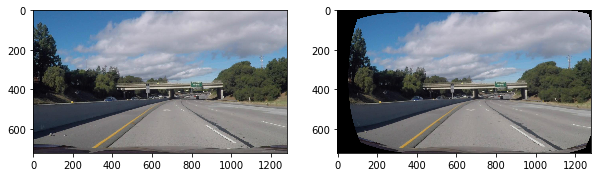

./test_images_challenge/test3.jpg


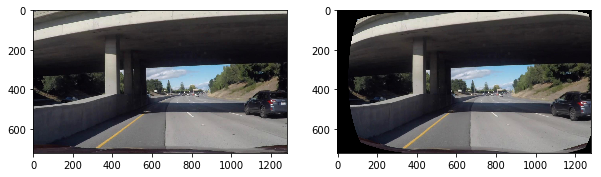

./test_images_challenge/test4.jpg


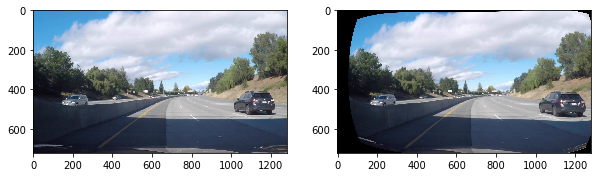

./test_images_challenge/test5.jpg


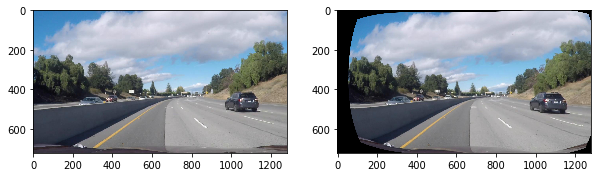

./test_images_challenge/test2.jpg


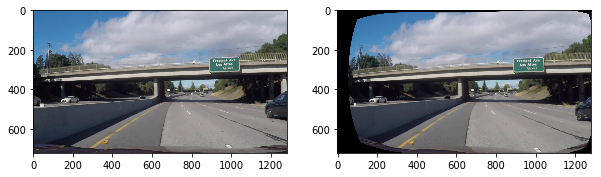

./test_images_challenge/test6.jpg


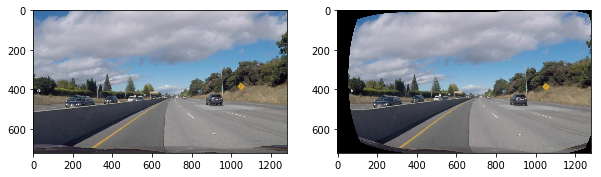

./camera_cal/calibration18.jpg
./test_images_challenge/test1.jpg


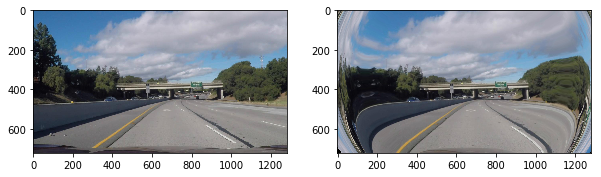

./test_images_challenge/test3.jpg


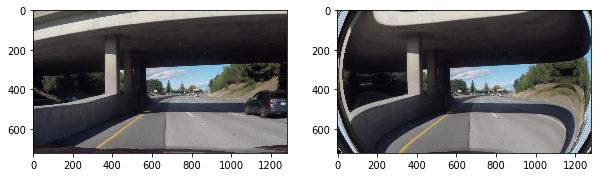

./test_images_challenge/test4.jpg


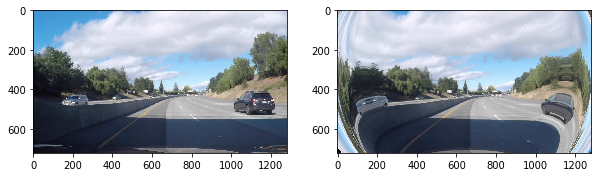

./test_images_challenge/test5.jpg


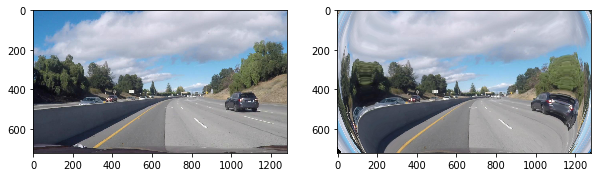

./test_images_challenge/test2.jpg


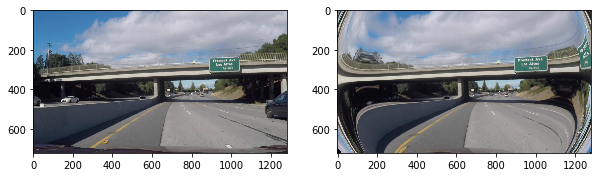

./test_images_challenge/test6.jpg


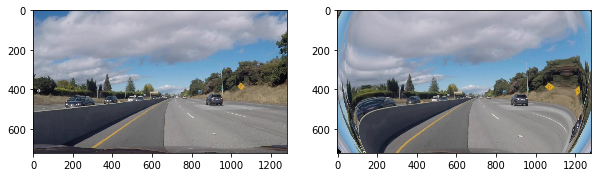

./camera_cal/calibration12.jpg
./test_images_challenge/test1.jpg


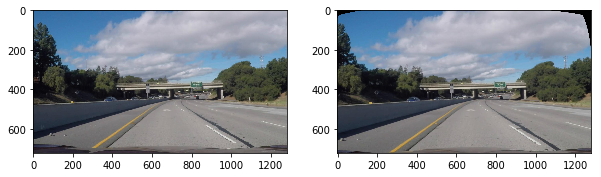

./test_images_challenge/test3.jpg


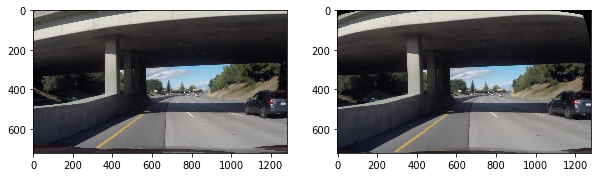

./test_images_challenge/test4.jpg


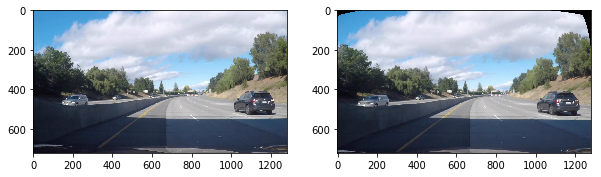

./test_images_challenge/test5.jpg


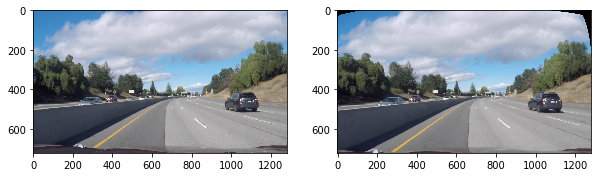

./test_images_challenge/test2.jpg


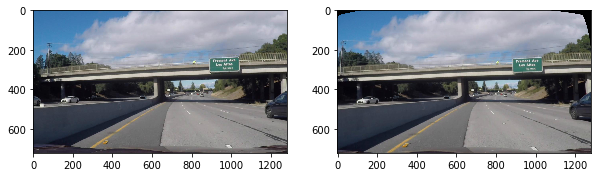

./test_images_challenge/test6.jpg


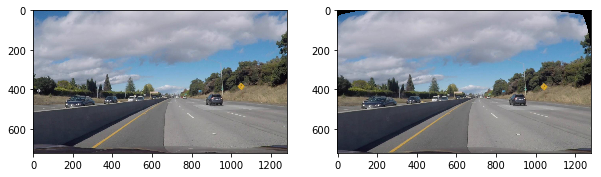

./camera_cal/calibration13.jpg
./test_images_challenge/test1.jpg


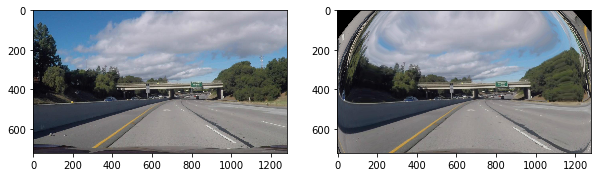

./test_images_challenge/test3.jpg


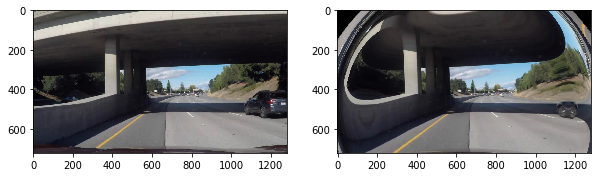

./test_images_challenge/test4.jpg


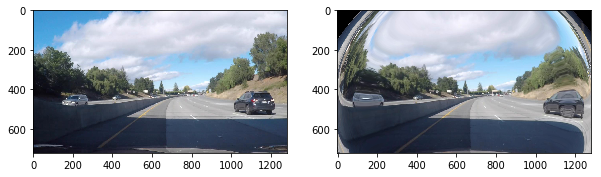

./test_images_challenge/test5.jpg


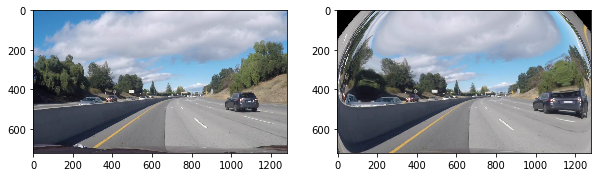

./test_images_challenge/test2.jpg


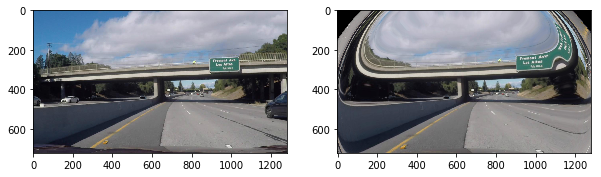

./test_images_challenge/test6.jpg


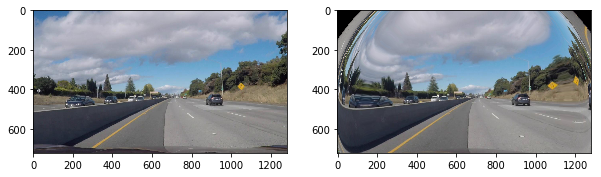

./camera_cal/calibration20.jpg
./test_images_challenge/test1.jpg


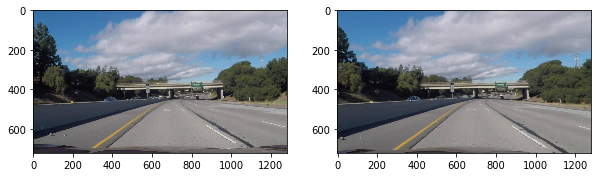

./test_images_challenge/test3.jpg


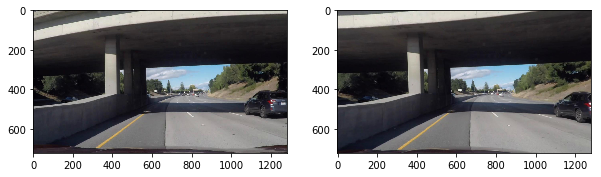

./test_images_challenge/test4.jpg


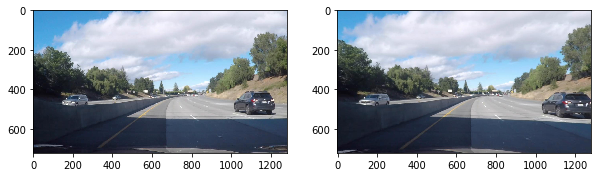

./test_images_challenge/test5.jpg


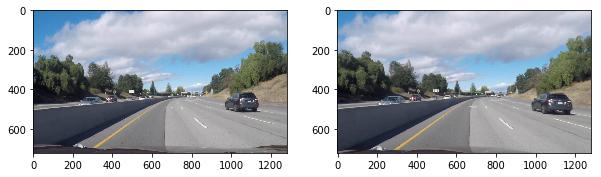

./test_images_challenge/test2.jpg


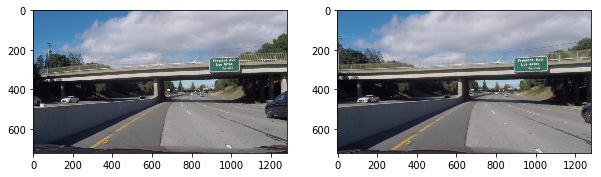

./test_images_challenge/test6.jpg


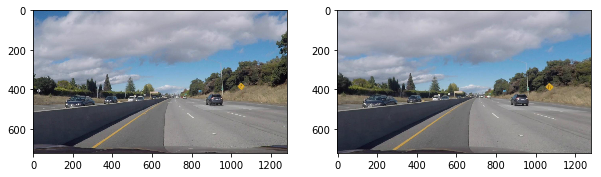

./camera_cal/calibration11.jpg
./test_images_challenge/test1.jpg


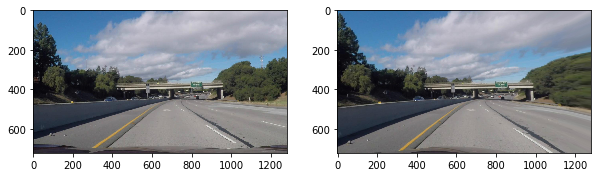

./test_images_challenge/test3.jpg


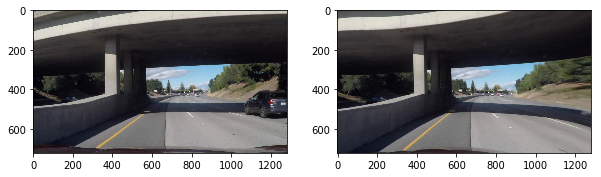

./test_images_challenge/test4.jpg


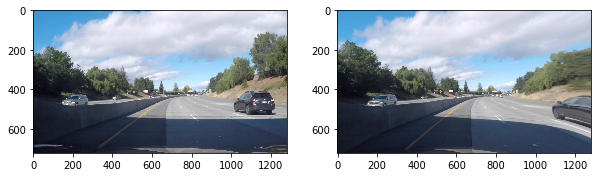

./test_images_challenge/test5.jpg


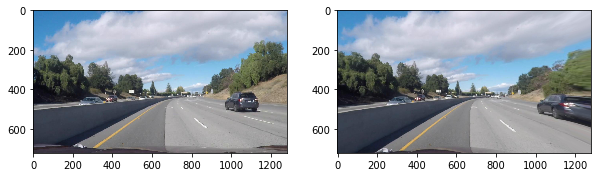

./test_images_challenge/test2.jpg


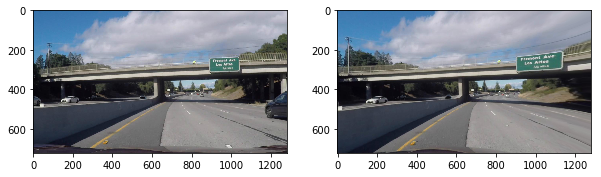

./test_images_challenge/test6.jpg


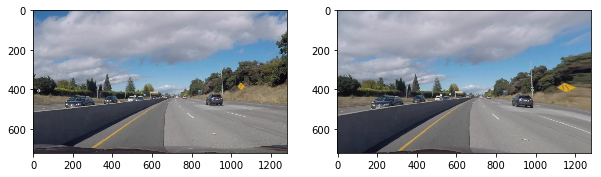

./camera_cal/calibration3.jpg
./test_images_challenge/test1.jpg


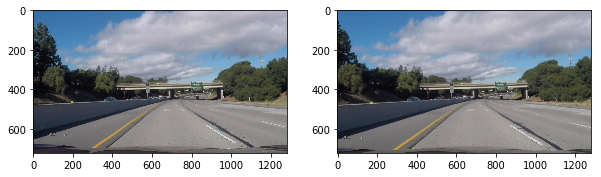

./test_images_challenge/test3.jpg


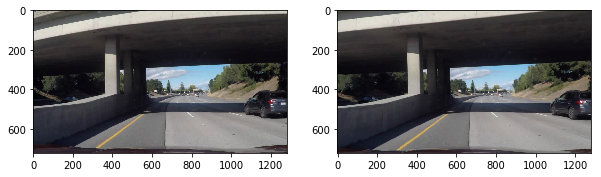

./test_images_challenge/test4.jpg


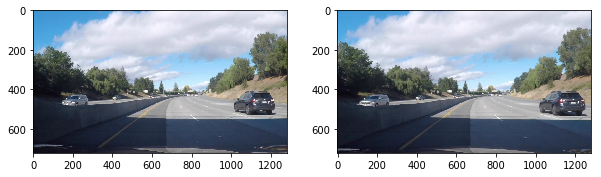

./test_images_challenge/test5.jpg


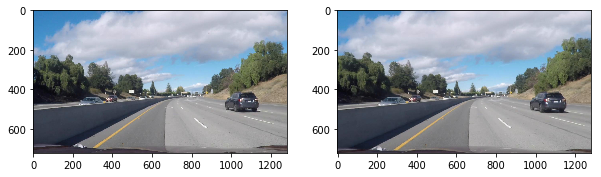

./test_images_challenge/test2.jpg


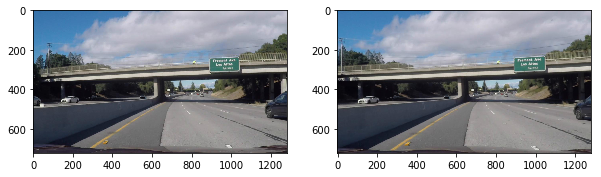

./test_images_challenge/test6.jpg


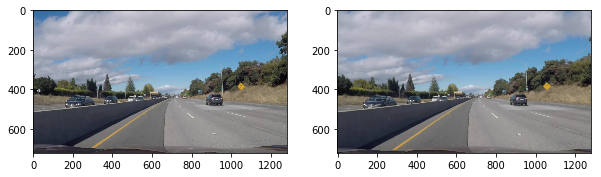

./camera_cal/calibration8.jpg
./test_images_challenge/test1.jpg


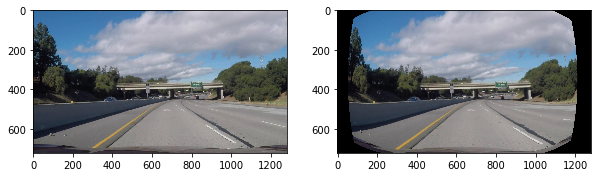

./test_images_challenge/test3.jpg


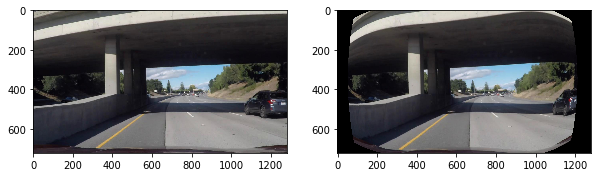

./test_images_challenge/test4.jpg


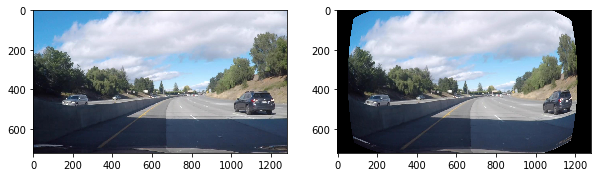

./test_images_challenge/test5.jpg


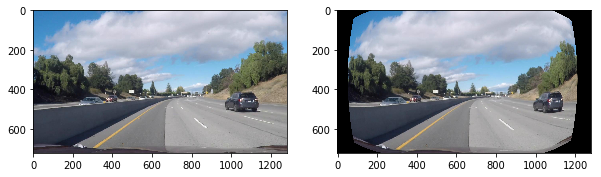

./test_images_challenge/test2.jpg


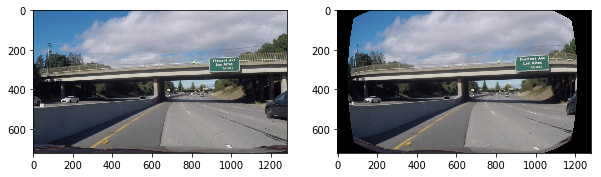

./test_images_challenge/test6.jpg


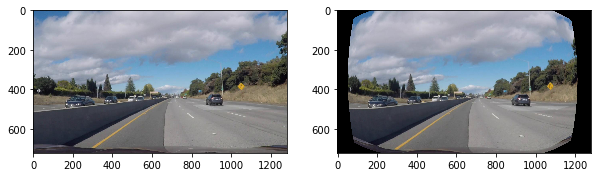

./camera_cal/calibration9.jpg
./test_images_challenge/test1.jpg


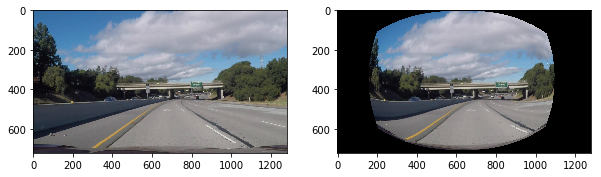

./test_images_challenge/test3.jpg


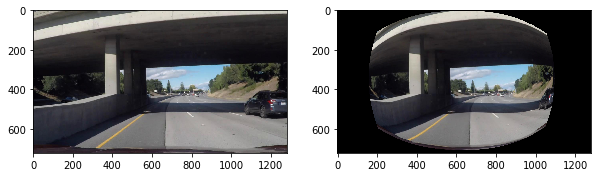

./test_images_challenge/test4.jpg


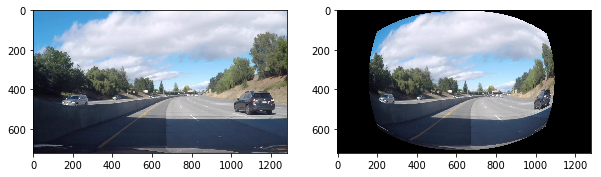

./test_images_challenge/test5.jpg


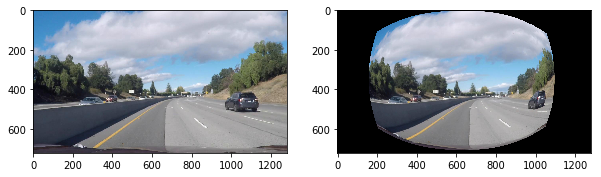

./test_images_challenge/test2.jpg


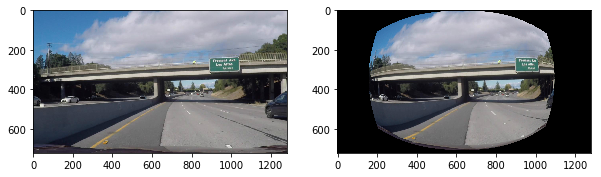

./test_images_challenge/test6.jpg


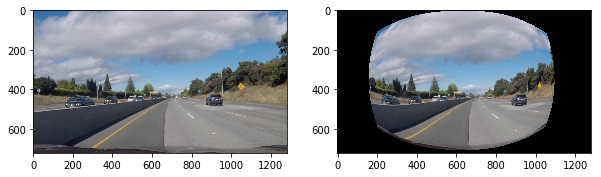

./camera_cal/calibration2.jpg
./test_images_challenge/test1.jpg


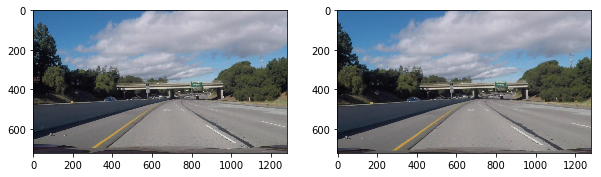

./test_images_challenge/test3.jpg


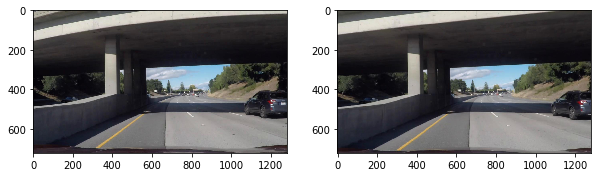

./test_images_challenge/test4.jpg


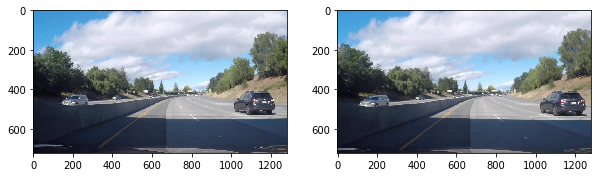

./test_images_challenge/test5.jpg


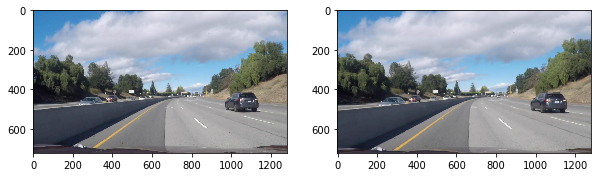

./test_images_challenge/test2.jpg


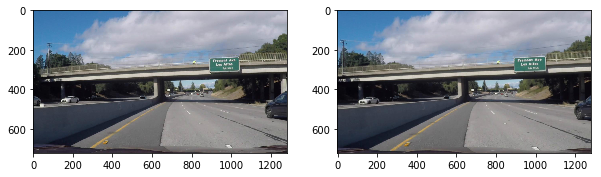

./test_images_challenge/test6.jpg


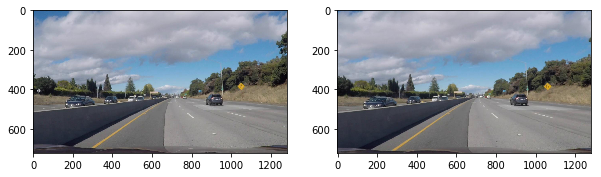

./camera_cal/calibration16.jpg
./test_images_challenge/test1.jpg


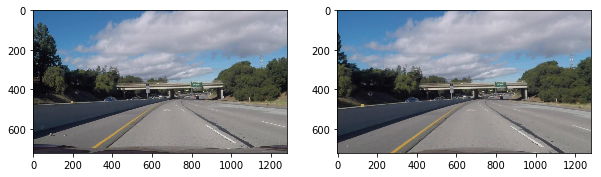

./test_images_challenge/test3.jpg


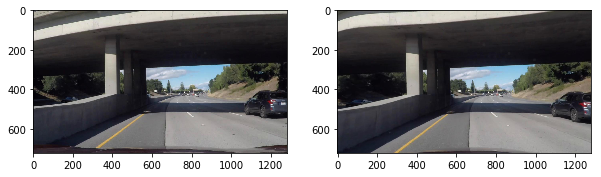

./test_images_challenge/test4.jpg


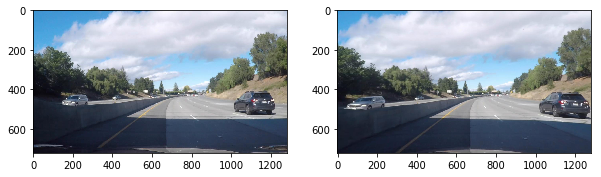

./test_images_challenge/test5.jpg


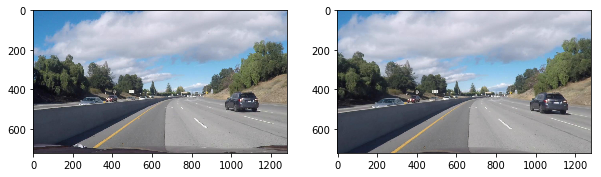

./test_images_challenge/test2.jpg


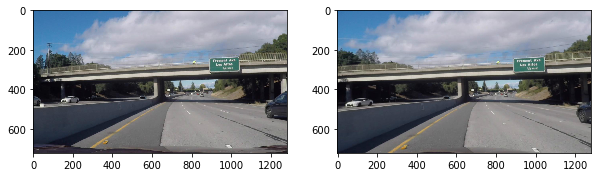

./test_images_challenge/test6.jpg


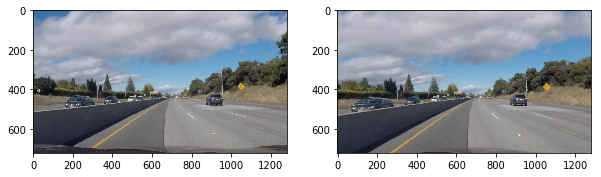

./camera_cal/calibration6.jpg
./test_images_challenge/test1.jpg


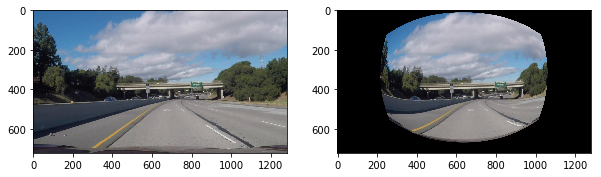

./test_images_challenge/test3.jpg


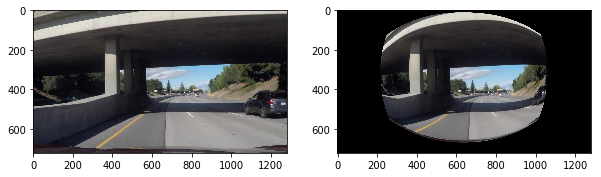

./test_images_challenge/test4.jpg


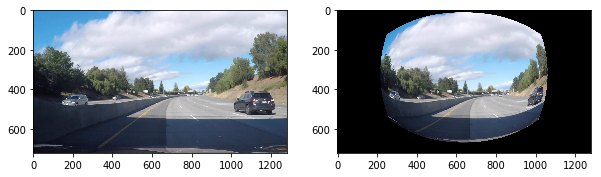

./test_images_challenge/test5.jpg


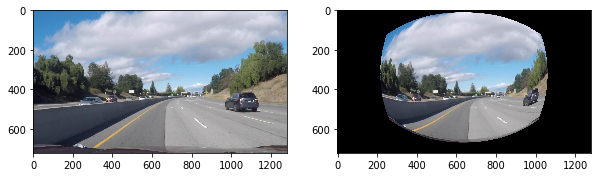

./test_images_challenge/test2.jpg


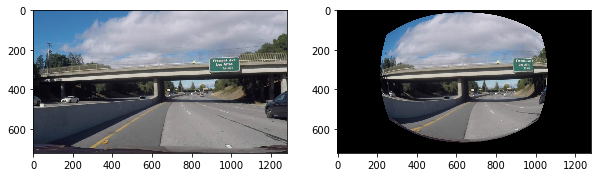

./test_images_challenge/test6.jpg


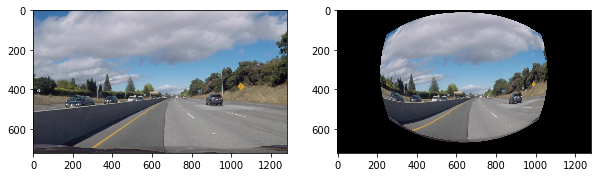

In [5]:
# Undistortion
test_img_paths = glob.glob(os.path.join(TEST_CHALLENGE_PATH, '*.jpg'))
for img_path, params in calibration_params.items():
    print(img_path)
    for idx, test_img_path in enumerate(test_img_paths):
        print(test_img_path)
        f, ax = plt.subplots(1, 2, figsize=(10, 10))
        test_img = mpimg.imread(test_img_path)
        undist = undistort(test_img, img_path)
        ax[0].imshow(test_img)
        ax[1].imshow(undist)
        plt.show()

./test_images_challenge/test1.jpg


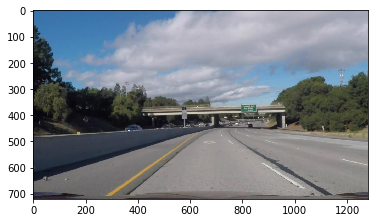

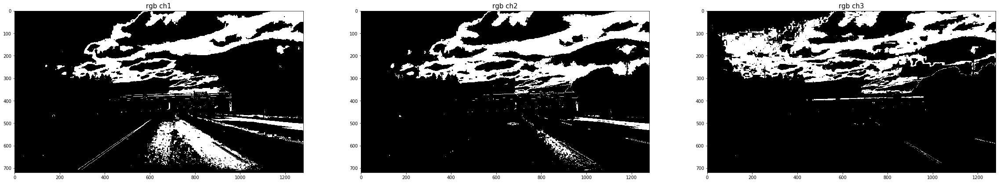

./test_images_challenge/test3.jpg


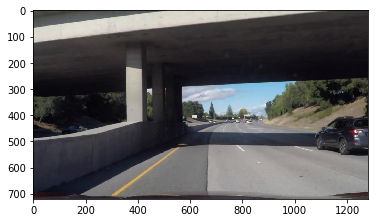

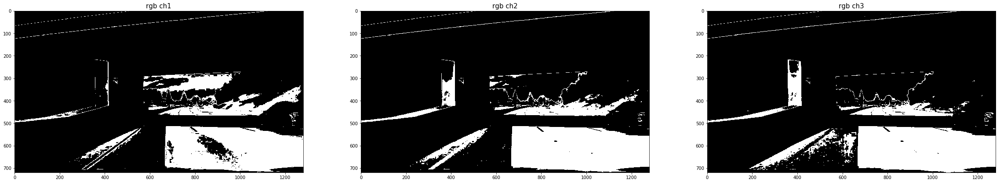

./test_images_challenge/test4.jpg


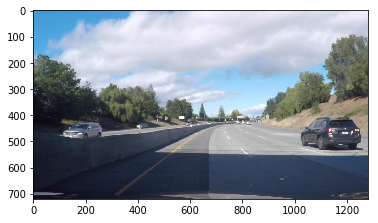

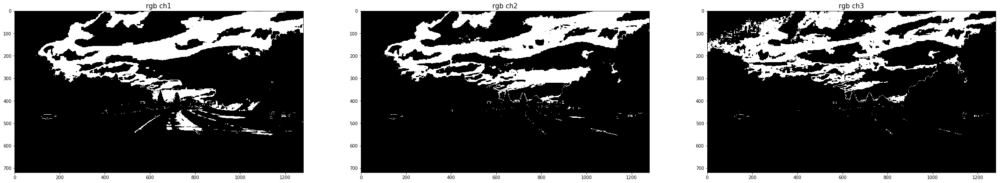

./test_images_challenge/test5.jpg


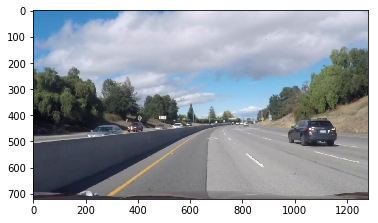

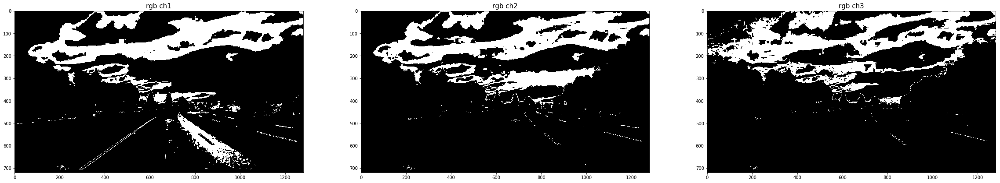

./test_images_challenge/test2.jpg


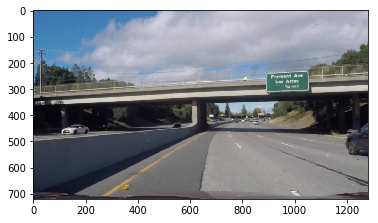

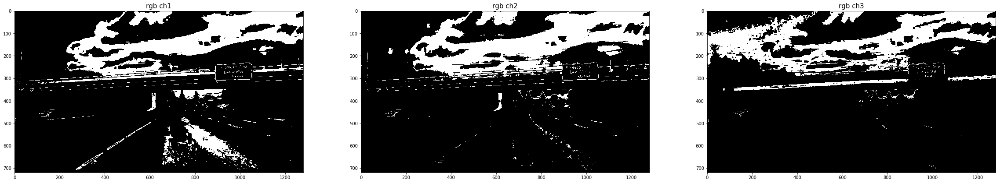

./test_images_challenge/test6.jpg


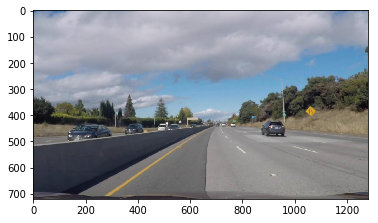

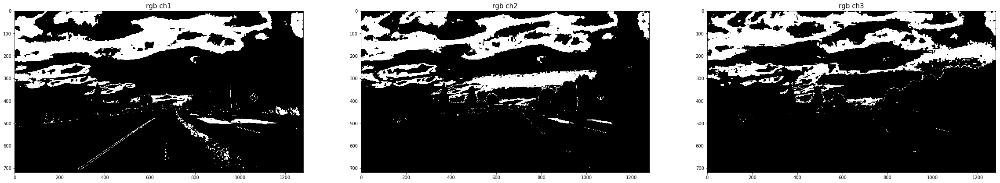

In [103]:
COLOR_SPACE_PARAMS = {
    'rgb': { 'thresh': (185, 230), 'cliplimit': 2.0 },
    ##'hls': { 'thresh': (220, 255), 'cliplimit': 10.0 },
    #'hsv': { 'thresh': (230, 255), 'cliplimit': 8.0 },
    #'luv': { 'thresh': (150, 255), 'cliplimit': 2.0 },
}

for test_img_path in test_img_paths:
    test_img = mpimg.imread(test_img_path)
    undist = undistort(test_img)
    gray = cv2.cvtColor(test_img, cv2.COLOR_RGB2GRAY)
    print(test_img_path)
    plt.imshow(undist)
    for color_space, params in COLOR_SPACE_PARAMS.items():
        ch1, ch2, ch3 = color_thresholding(undist, space=color_space, thresh=params['thresh'],
                                           cliplimit=params['cliplimit'], equalize=True, plot=True)
    plt.show()

./test_images_challenge/test1.jpg


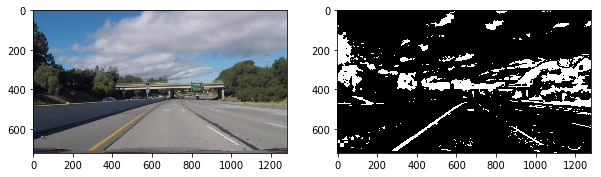

./test_images_challenge/test3.jpg


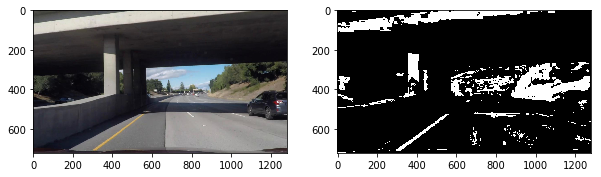

./test_images_challenge/test4.jpg


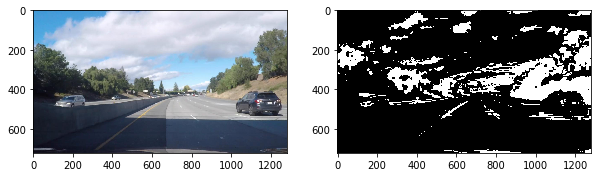

./test_images_challenge/test5.jpg


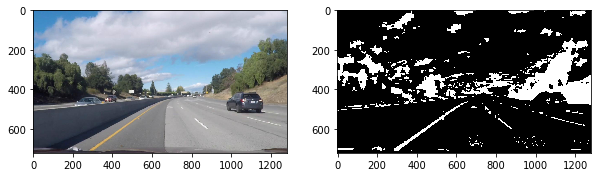

./test_images_challenge/test2.jpg


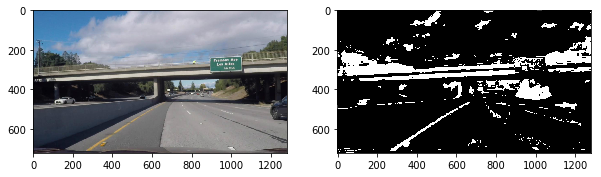

./test_images_challenge/test6.jpg


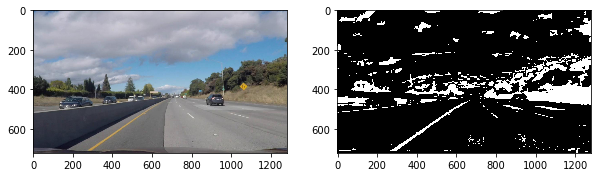

In [89]:
for test_img_path in test_img_paths:
    test_img = mpimg.imread(test_img_path)
    undist = undistort(test_img)
    combined = combined_color_thresholding(undist)
    
    print(test_img_path)
    f, ax = plt.subplots(1, 2, figsize=(10, 10))
    ax[0].imshow(undist)
    ax[1].imshow(combined, cmap='gray')
    plt.show()

./test_images_challenge/test1.jpg


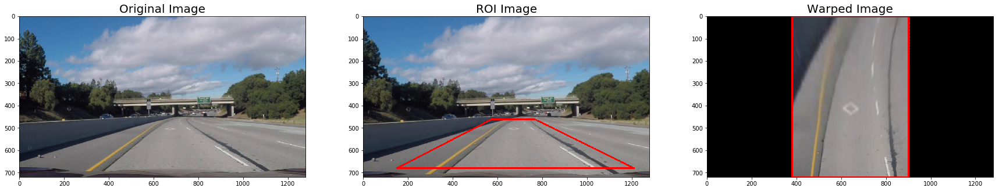

./test_images_challenge/test3.jpg


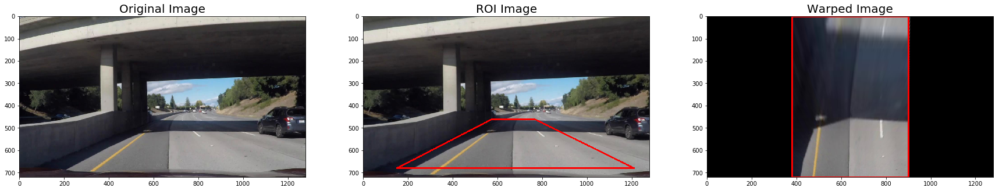

./test_images_challenge/test4.jpg


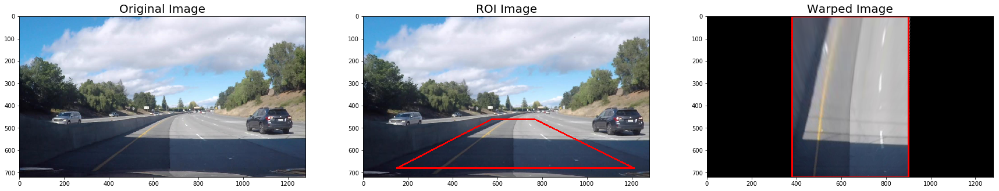

./test_images_challenge/test5.jpg


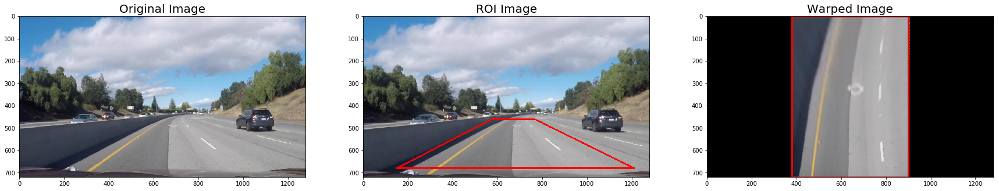

./test_images_challenge/test2.jpg


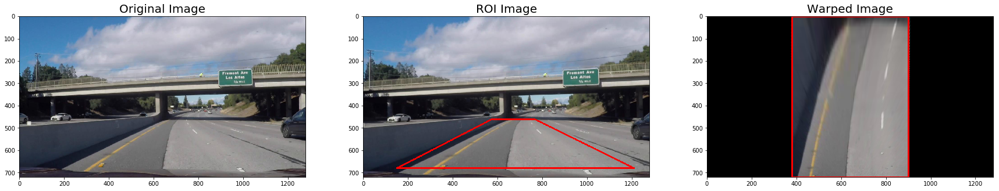

./test_images_challenge/test6.jpg


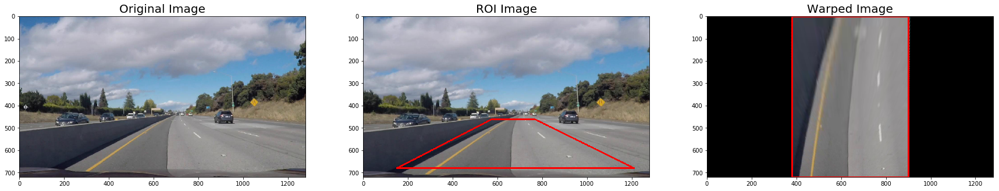

In [93]:
src = np.float32([[575, 460],
                [150, 680],
                [1210, 680],
                [765, 460]])
dst = np.float32([[380, 0],
                [380, 720],
                [900, 720],
                [900, 0]])

for test_img_path in test_img_paths:
    test_img = mpimg.imread(test_img_path)
    undist = undistort(test_img)
    warped, _, _ = birds_eye_perspective_transform(undist)
    
    # Draw ROI lines
    cv2.polylines(undist, np.int32([src]), True, (255, 0, 0), 5)
    cv2.polylines(warped, np.int32([dst]), True, (255, 0, 0), 5)

    print(test_img_path)
    f, ax = plt.subplots(1, 3, figsize=(30, 30))
    ax[0].imshow(test_img)
    ax[0].set_title('Original Image', fontsize=20)
    ax[1].imshow(undist)
    ax[1].set_title('ROI Image', fontsize=20)
    ax[2].imshow(warped)
    ax[2].set_title('Warped Image', fontsize=20)
    plt.show()

./test_images_challenge/test1.jpg


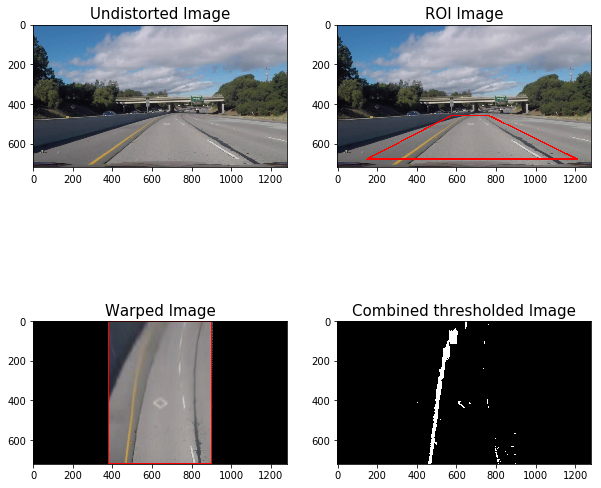

./test_images_challenge/test3.jpg


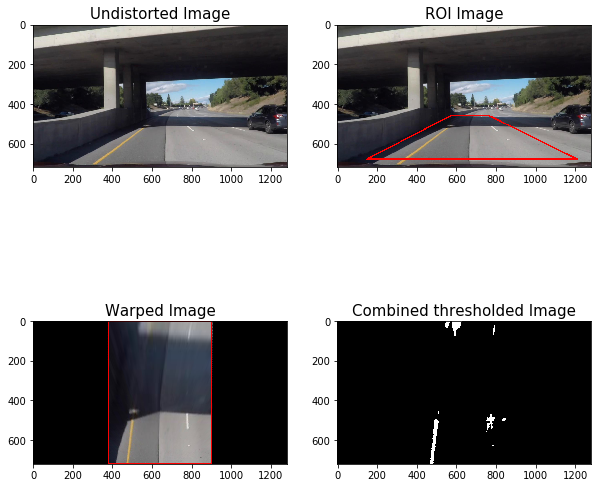

./test_images_challenge/test4.jpg


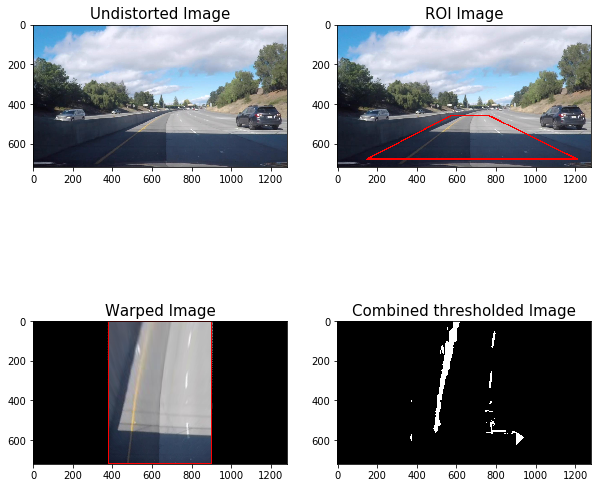

./test_images_challenge/test5.jpg


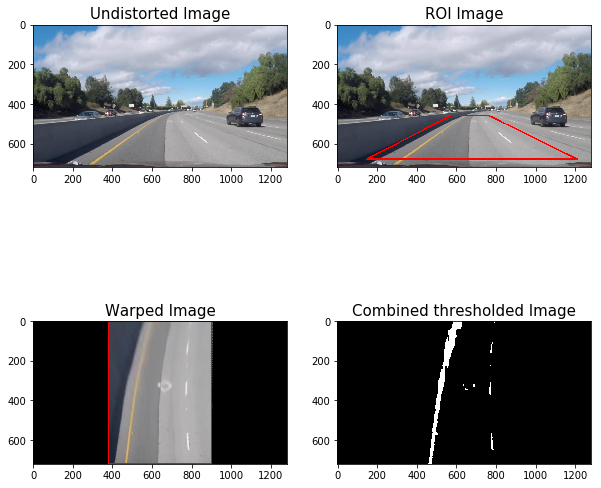

./test_images_challenge/test2.jpg


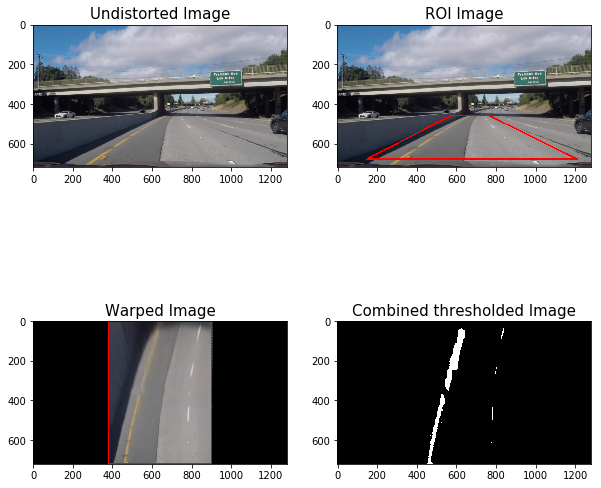

./test_images_challenge/test6.jpg


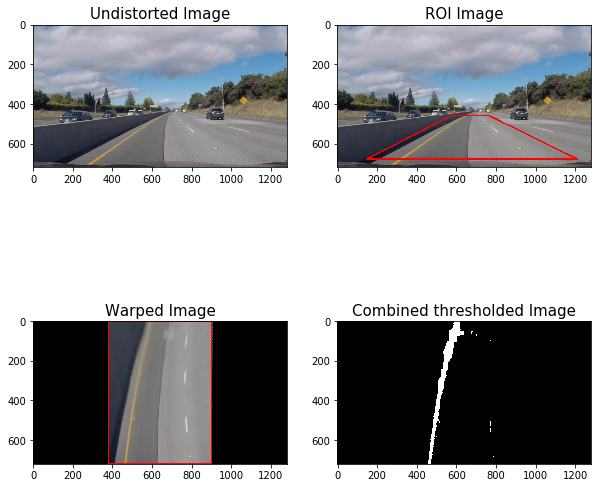

In [94]:
for test_img_path in test_img_paths:
    test_img = mpimg.imread(test_img_path)
    print(test_img_path)
    process_image(test_img, plot=True)
    plt.show()